In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2

In [2]:
df = pd.read_csv('Data/train.csv')

In [3]:
def show_pet(record, size_square=None, feature='Pawpularity', title=None):
    if not size_square:
        path = f"Data/train/{record['Id']}.jpg"
        img = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
        title = plt.title(f"{feature}: {record[feature]}")
        plt.imshow(img)
        
    else:
        if len(record) != size_square*size_square:
            print('Wrong size')
            return
        plt.figure(figsize=(size_square*3, size_square*4))
        for i in range(size_square*size_square):
            path = f"Data/train/{record['Id'].iloc[i]}.jpg"
            img = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
            plt.subplot(size_square, size_square, i+1)
            plt.title(f"{feature}: {record[feature].iloc[i]}")
            plt.imshow(img)
        if title:
            plt.suptitle(f'\n{title}\n', fontsize=15)
        plt.tight_layout()
        plt.show()
        plt.close()

In [4]:
df.columns

Index(['Id', 'Subject Focus', 'Eyes', 'Face', 'Near', 'Action', 'Accessory',
       'Group', 'Collage', 'Human', 'Occlusion', 'Info', 'Blur',
       'Pawpularity'],
      dtype='object')

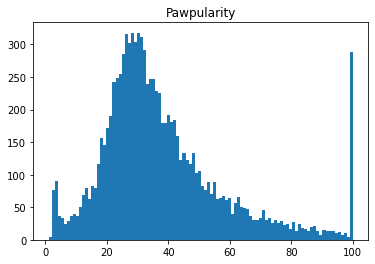

In [5]:
plt.hist(df['Pawpularity'], bins=100)
plt.title('Pawpularity')
plt.show()

## Mało popularne zwierzęta

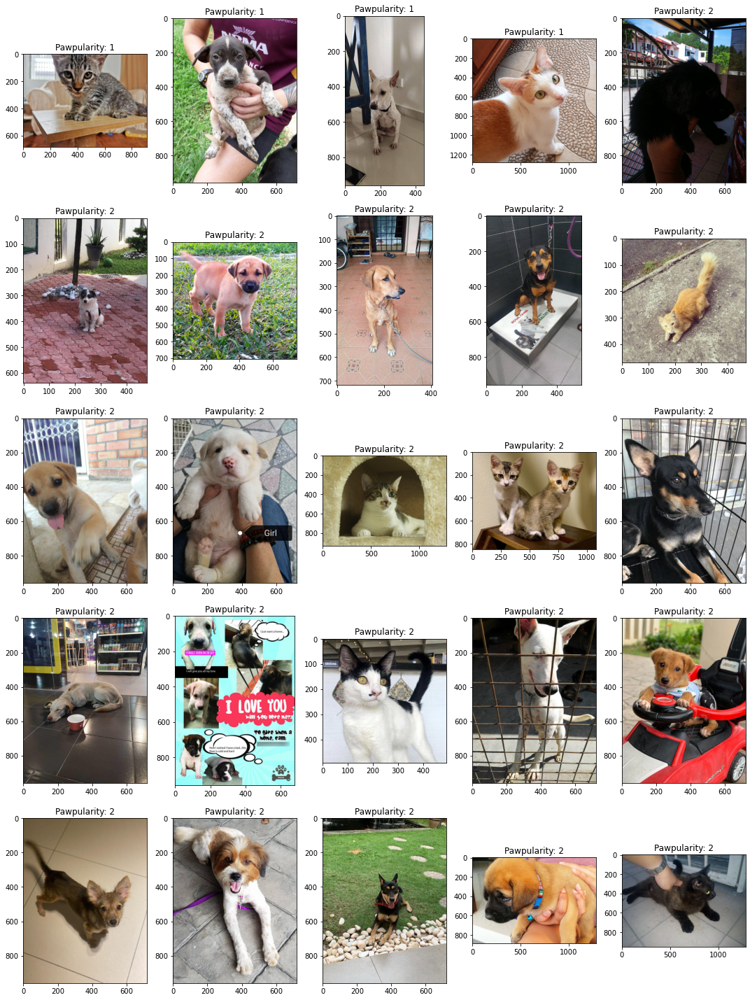

In [6]:
show_pet(df.sort_values(by=['Pawpularity'])[:25], 5)

## Zwierzęta reprezentujące medianę popularności

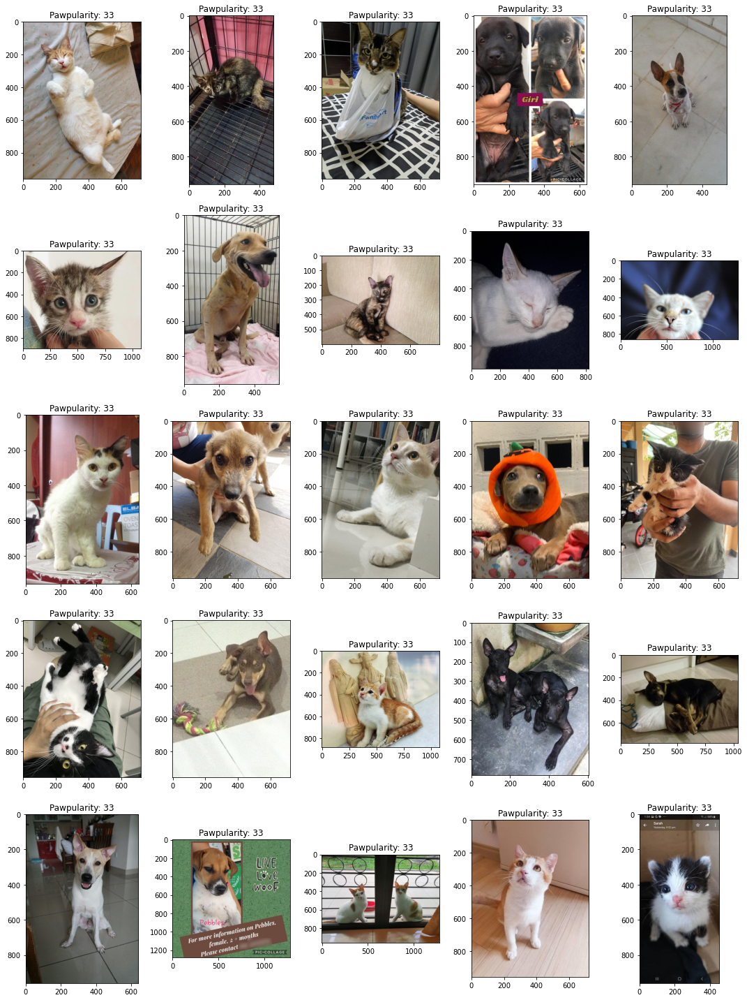

In [7]:
show_pet(df[df['Pawpularity']==df['Pawpularity'].median()][:25], 5)

## Najpopularniejsze zwierzęta

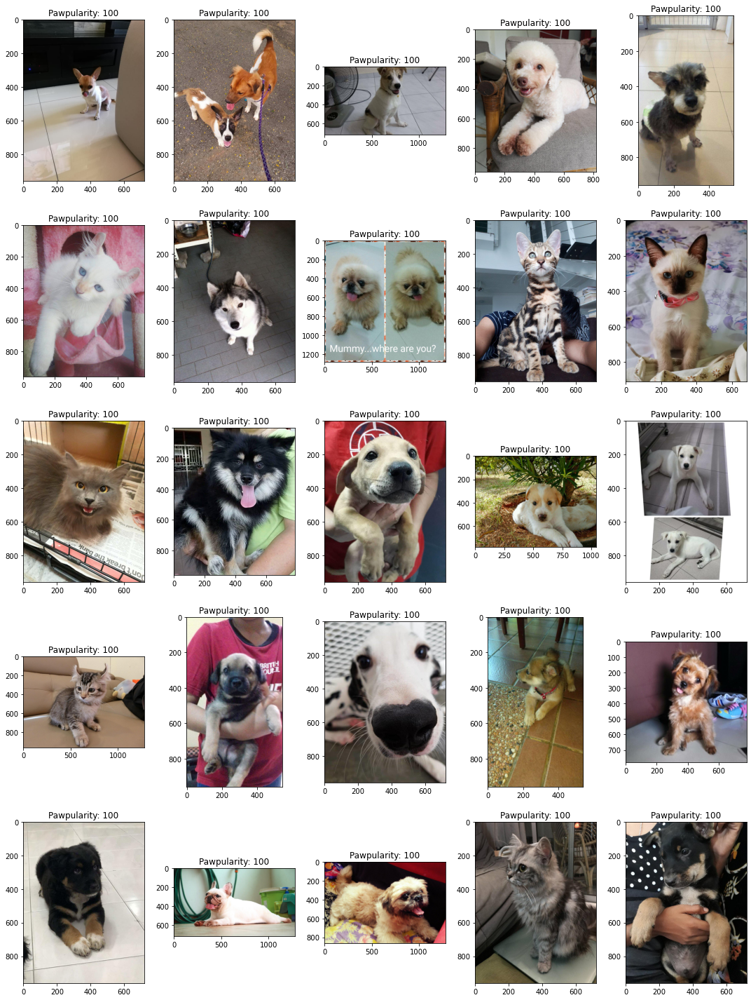

In [8]:
show_pet(df[df['Pawpularity']==100][:25], 5)


# Metadane zdjęć
Oprócz zdjęć mamy również informację o metadanych zdjęć. Każde onzaczone 0 lub 1 (Tak/Nie).
Poniżej zamieszczono definicje każdej z pozycji wraz z przykładami z bazy.

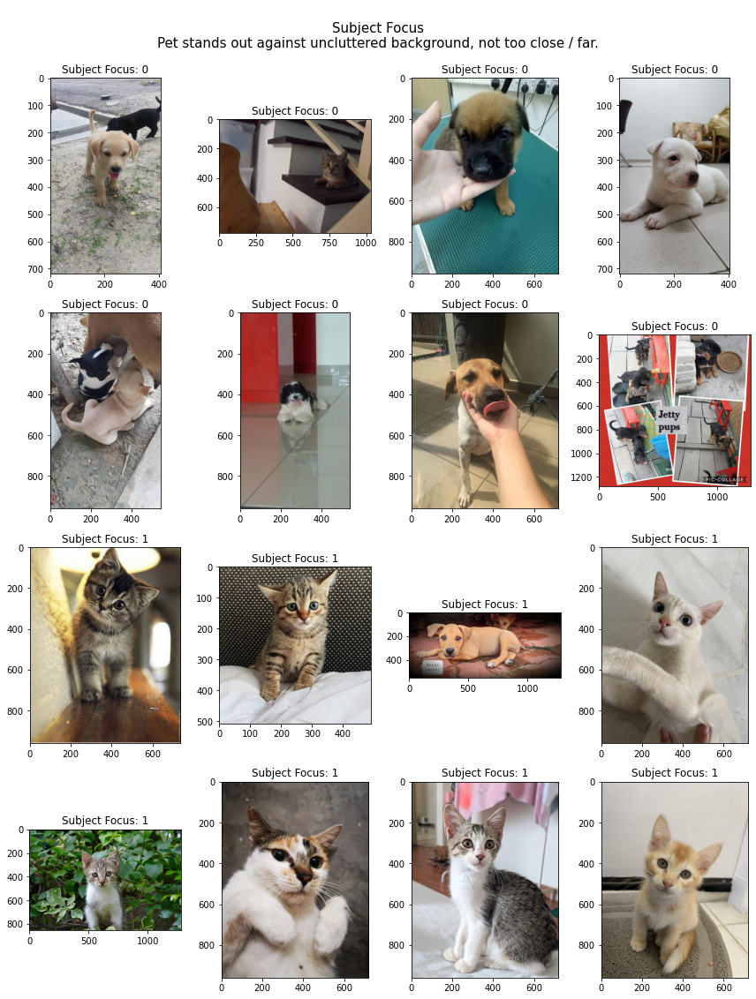

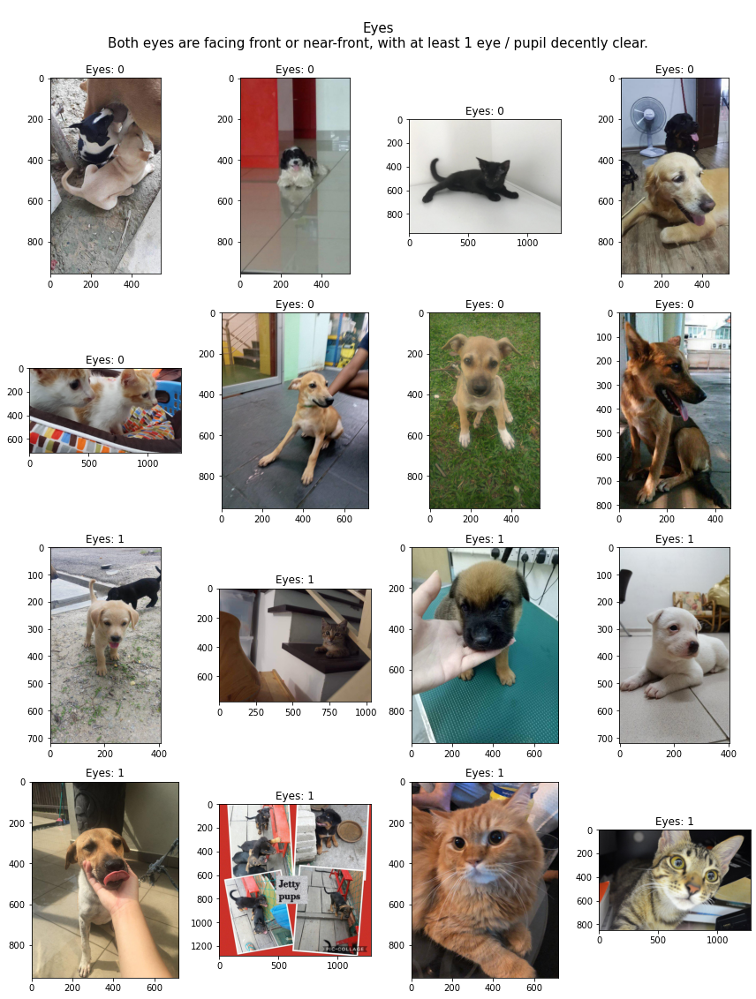

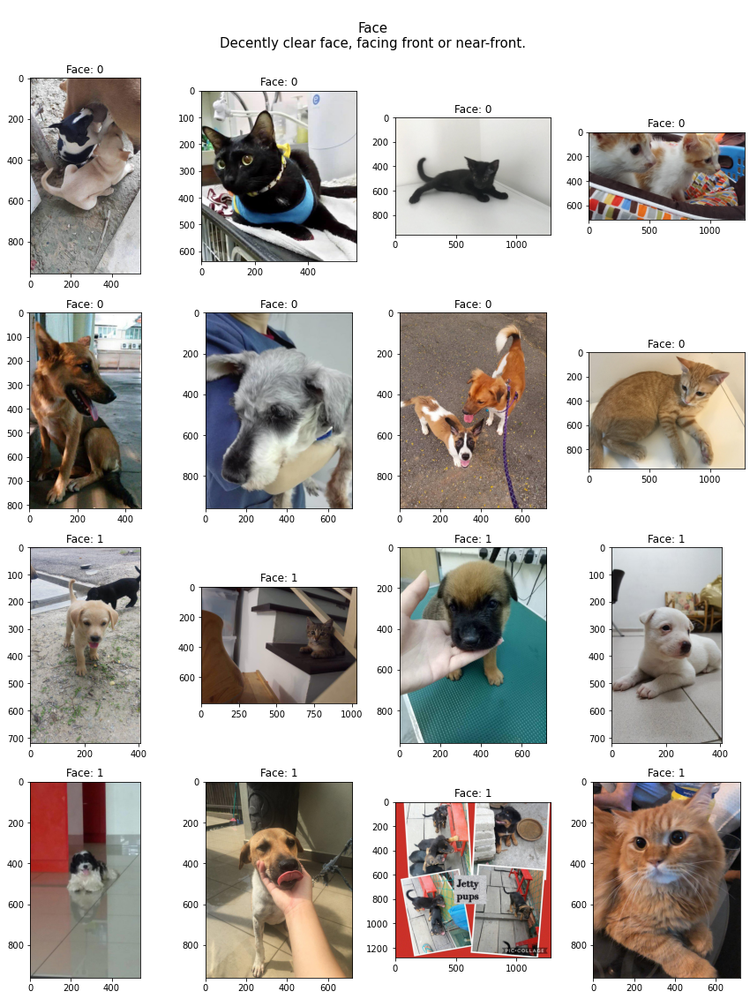

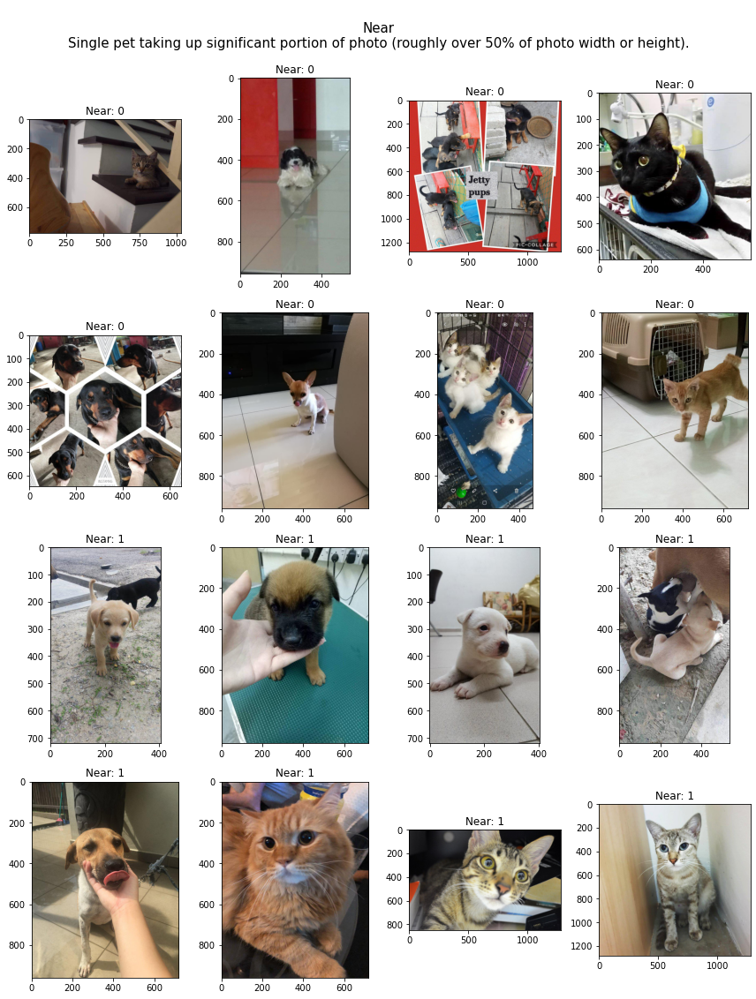

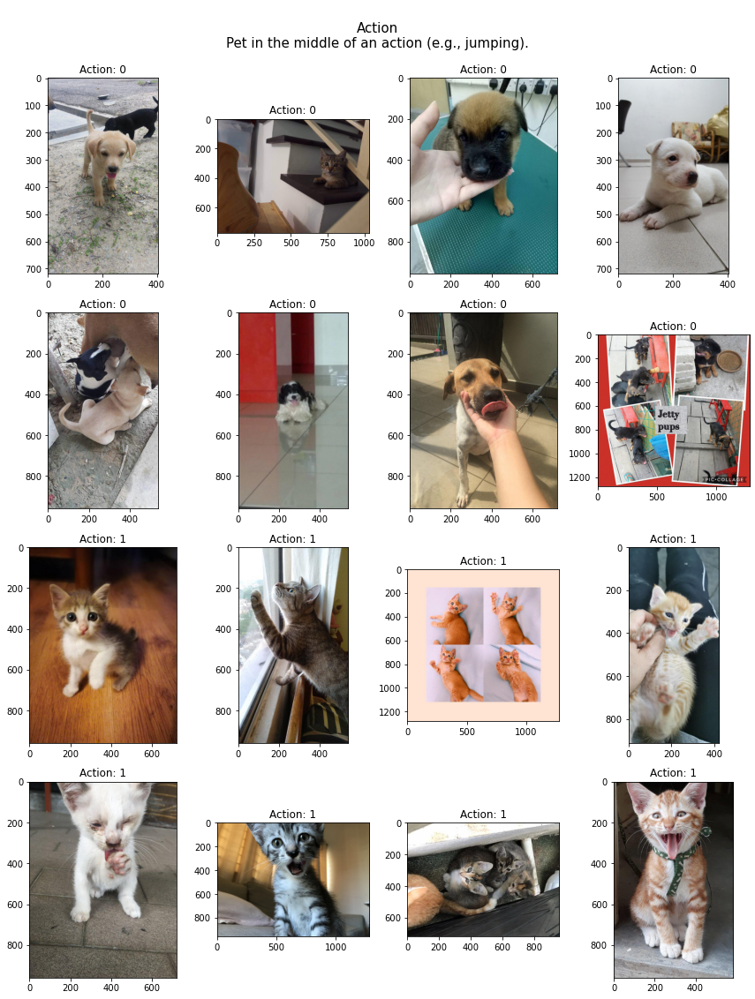

...

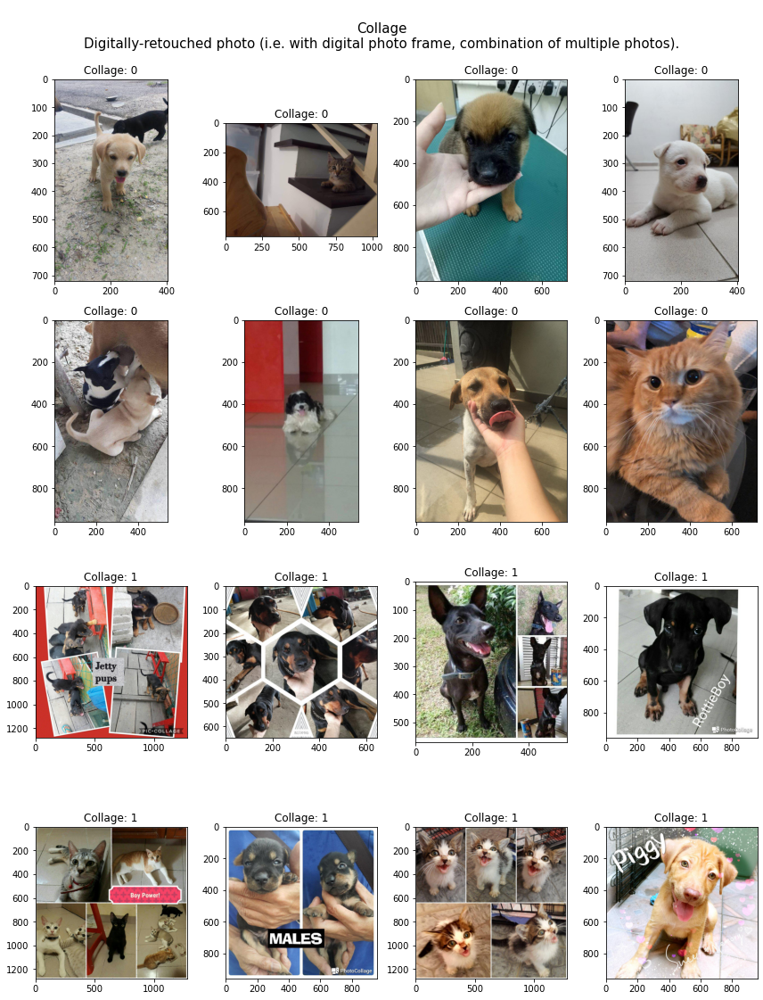

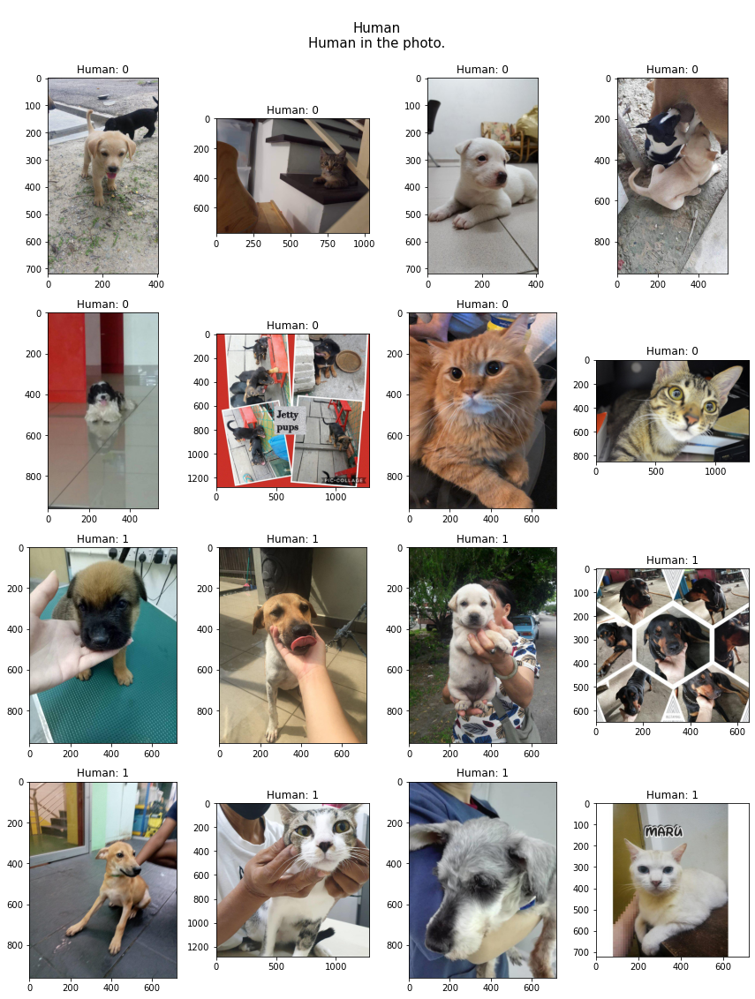

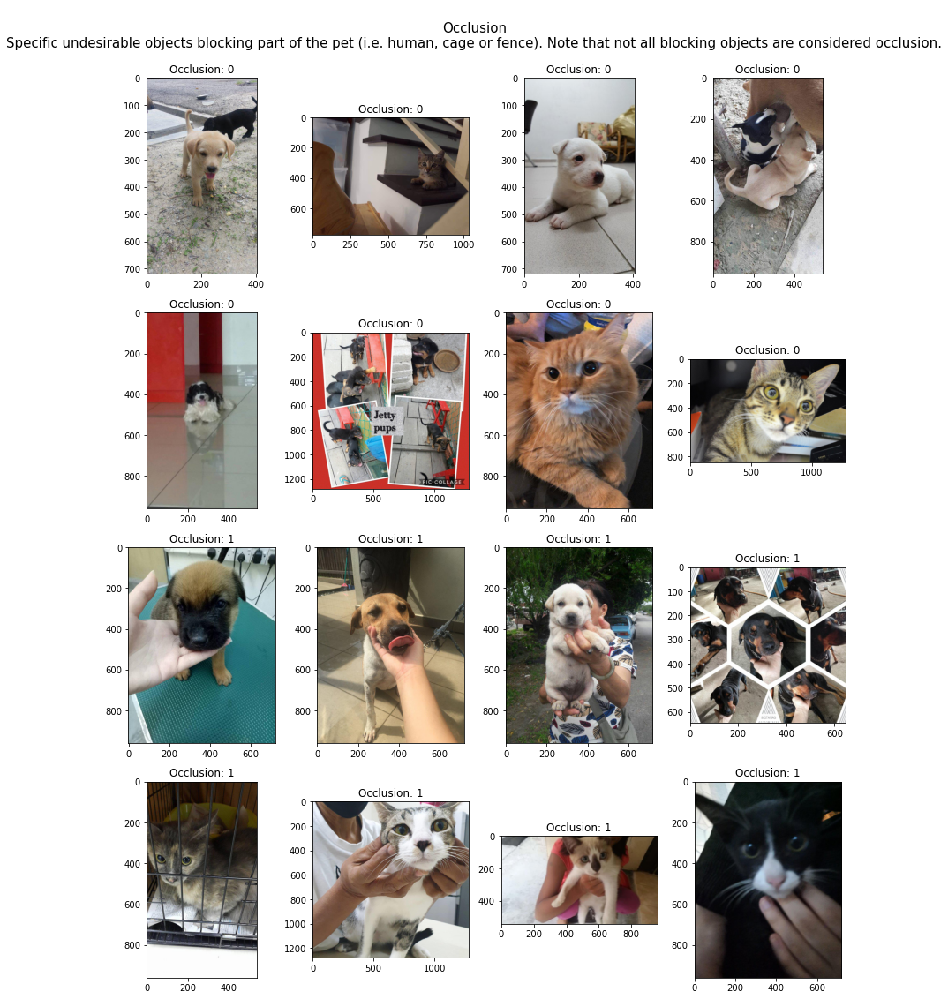

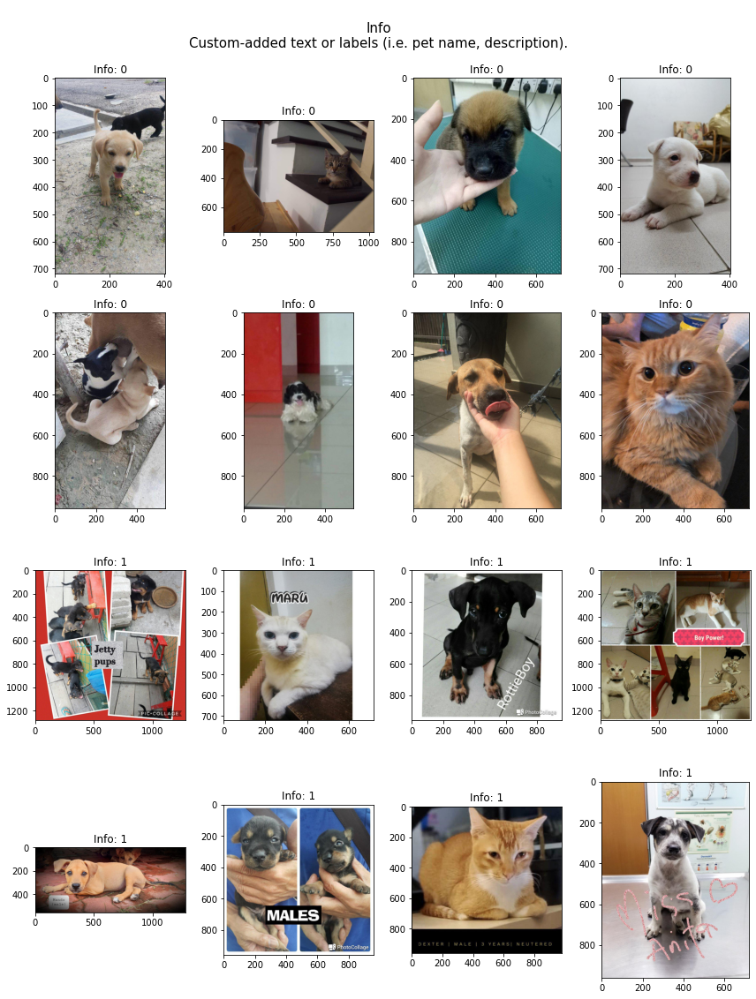

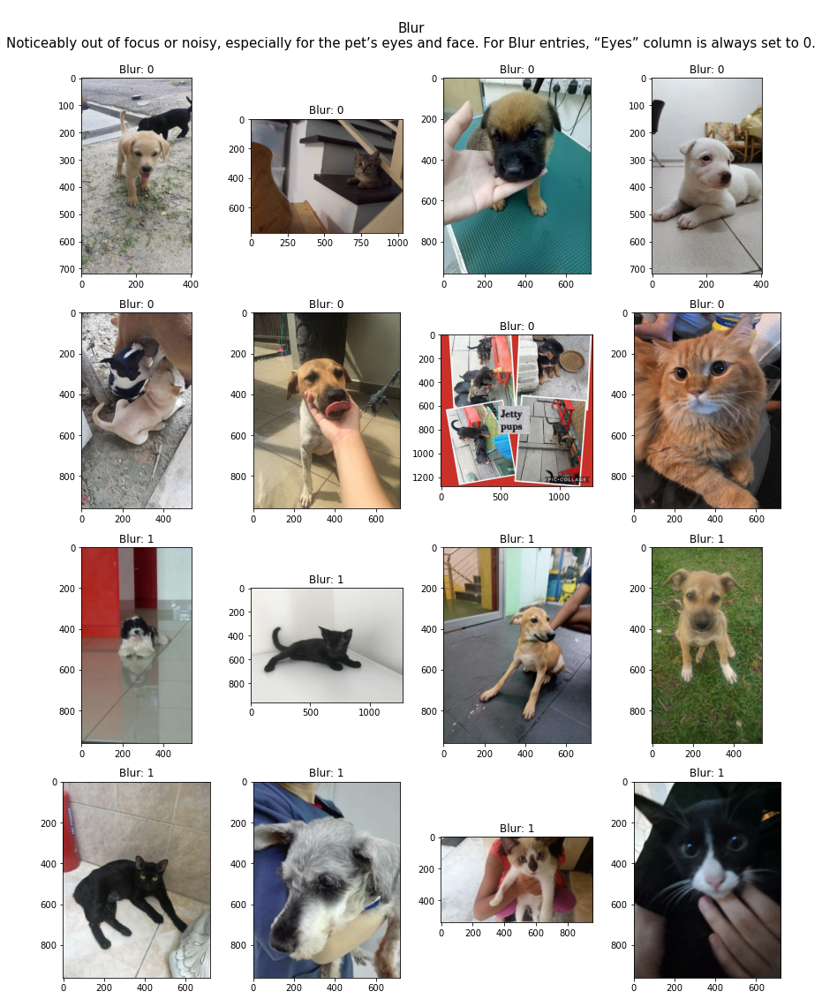

In [9]:
features = {'Subject Focus':'Pet stands out against uncluttered background, not too close / far.',
            'Eyes': 'Both eyes are facing front or near-front, with at least 1 eye / pupil decently clear.',
            'Face': 'Decently clear face, facing front or near-front.',
            'Near': 'Single pet taking up significant portion of photo (roughly over 50% of photo width or height).',
            'Action': 'Pet in the middle of an action (e.g., jumping).',
            'Accessory': 'Accompanying physical or digital accessory / prop (i.e. toy, digital sticker), excluding collar and leash.',
            'Group':'More than 1 pet in the photo.',
            'Collage': 'Digitally-retouched photo (i.e. with digital photo frame, combination of multiple photos).',
            'Human': 'Human in the photo.',
            'Occlusion': 'Specific undesirable objects blocking part of the pet (i.e. human, cage or fence). Note that not all blocking objects are considered occlusion.',
            'Info': 'Custom-added text or labels (i.e. pet name, description).',
            'Blur': 'Noticeably out of focus or noisy, especially for the pet’s eyes and face. For Blur entries, “Eyes” column is always set to 0.'}
for f_key in features:
    show_pet(pd.concat([df[df[f_key]==0][:8], df[df[f_key]==1][:8]]), 4, f_key, f"{f_key}\n{features[f_key]}")

In [10]:
feature = 'Eyes'
pd.concat([df[df[feature]==0][:8], df[df[feature]==1][:8]])

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72
5,001dd4f6fafb890610b1635f967ea081,0,0,1,0,0,0,0,0,0,0,0,1,74
16,006cda7fec46a527f9f627f4722a2304,0,0,0,1,0,0,0,0,0,0,0,1,34
18,0075ec6503412f21cf65ac5f43d80440,0,0,1,1,0,0,0,0,0,0,0,0,53
21,00838b02764e8d37edde39ed18693427,0,0,0,1,0,0,1,0,0,0,0,0,27
25,0095f81bab3b68a4f70e99f0fcec7b06,0,0,1,1,0,0,0,0,1,0,0,1,15
29,00b151a572c9aabedf8cfce0fa18be25,0,0,1,1,0,0,0,0,0,0,0,1,21
34,00df0a668441b10869f4372fd15c14f5,0,0,0,1,0,0,0,0,0,0,0,0,69
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42


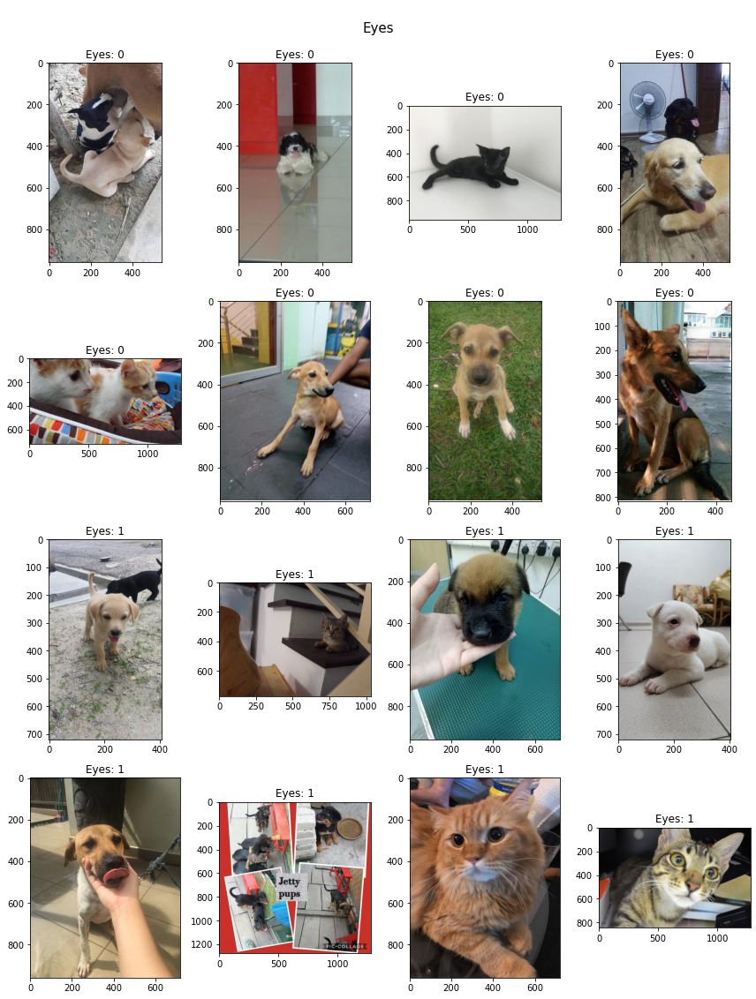

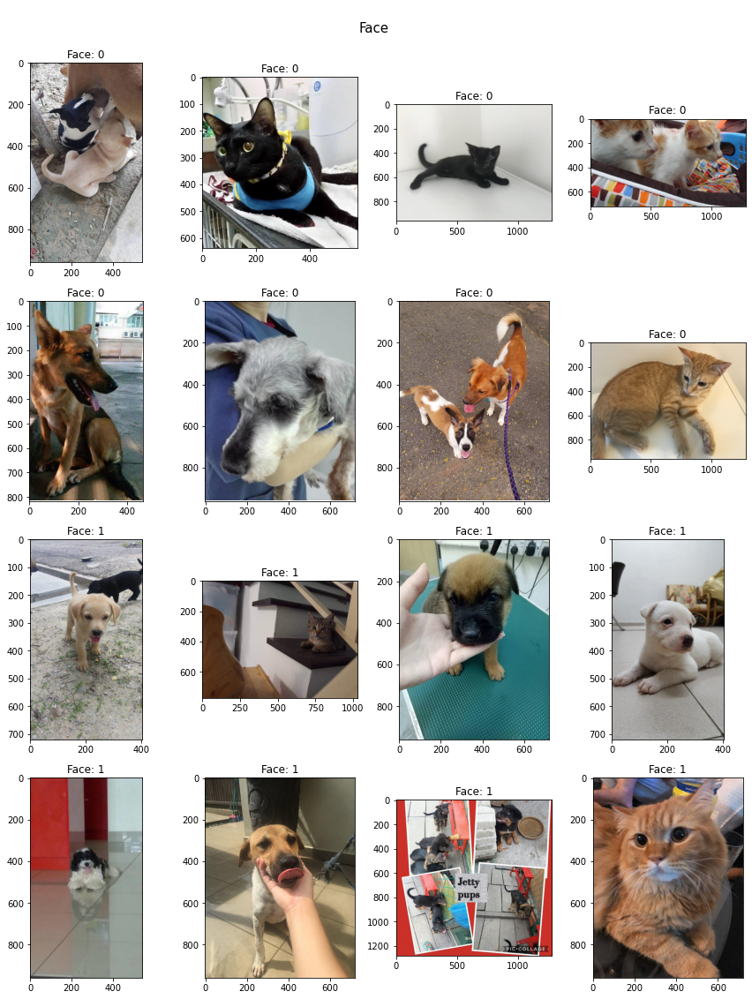

In [11]:
feature = 'Eyes'
show_pet(pd.concat([df[df[feature]==0][:8], df[df[feature]==1][:8]]), 4, feature, feature)

feature = 'Face'
show_pet(pd.concat([df[df[feature]==0][:8], df[df[feature]==1][:8]]), 4, feature, feature)